In [61]:
import warnings
warnings.filterwarnings('ignore')

In [62]:
import tensorflow as tf
import os
import random
import numpy as np

from tqdm import tqdm 

from skimage.io import imread, imshow
from skimage.transform import resize
import matplotlib.pyplot as plt

In [114]:
seed = 42
np.random.seed = seed

IMG_WIDTH = 256
IMG_HEIGHT = 256
IMG_CHANNELS = 3

TRAIN_PATH_x = 'power_line_dataset4/images'
TRAIN_PATH_y = 'power_line_dataset4/masks'
# TEST_PATH = 'stage1_test/'
sub_feat = sorted(os.listdir(TRAIN_PATH_x))
sub_label = sorted(os.listdir(TRAIN_PATH_y))
# train_ids = next(os.walk(TRAIN_PATH))[1]
# test_ids = next(os.walk(TEST_PATH))[1]

X_train = np.zeros((len(sub_feat), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
Y_train = np.zeros((len(sub_label), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)


In [115]:
for i in range(len(sub_feat)):
    img = imread(TRAIN_PATH_x+'/'+sub_feat[i])
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_train[i] = img
    
    img2 = imread(TRAIN_PATH_y+'/'+sub_label[i])
    img2 = resize(img2, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    Y_train[i] = img2[:,:,1].reshape(img2[:,:,1].shape[0],img2[:,:,1].shape[1],1)

In [116]:
# print('Resizing training images and masks')
# for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):
#     print(n,id_)
#     path = TRAIN_PATH + id_
#     img = imread(path + '/images/' + id_ + '.jpg')[:,:,:IMG_CHANNELS]  
#     img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
#     X_train[n] = img  #Fill empty X_train with values from img
    
# # #     mask_ = imread(path + '/masks/' + mask_file)
    
# # #     mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
# # #     for mask_file in next(os.walk(path + '/masks/'))[2]:
# # #         mask_ = imread(path + '/masks/' + mask_file)
# # #         mask_ = np.expand_dims(resize(mask_, (IMG_HEIGHT, IMG_WIDTH), mode='constant',  
# # #                                       preserve_range=True), axis=-1)
# # #         mask = np.maximum(mask, mask_)  
            
# # #     Y_train[n] = mask   


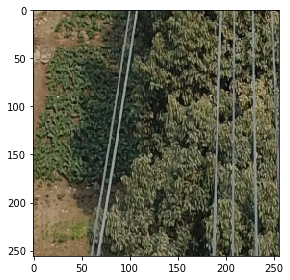

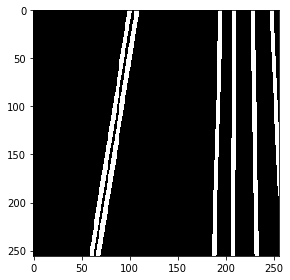

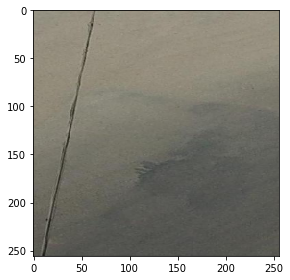

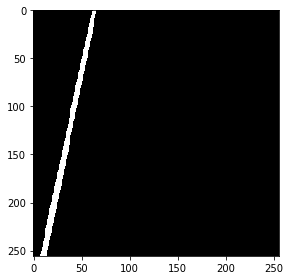

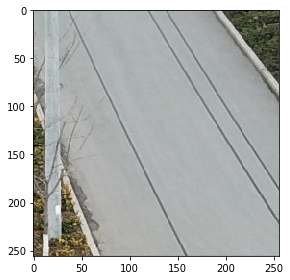

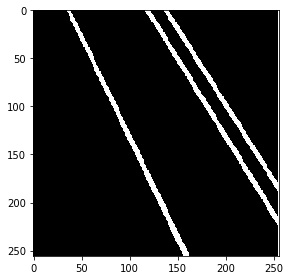

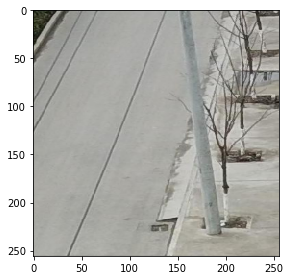

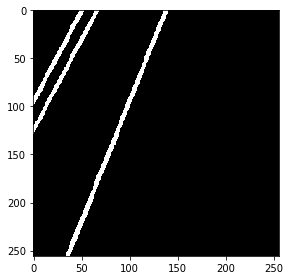

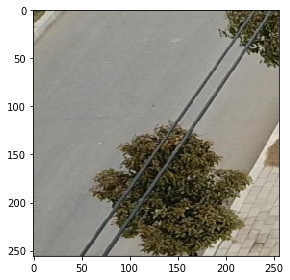

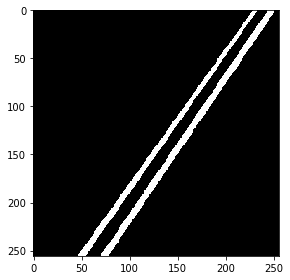

In [117]:
for i in range(5):
    imshow(X_train[i])
    plt.show()
    imshow(Y_train[i],cmap='gray')
    plt.show()

In [118]:
def contrac_conv_block(inp, num_filt, kernel,activation, drop_rate, initializer = 'he_normal' ,padding = 'same'):
    c = tf.keras.layers.Conv2D(num_filt, kernel, activation=activation, kernel_initializer = initializer, padding = padding)(inp)
    c = tf.keras.layers.Dropout(drop_rate)(c)
    c = tf.keras.layers.Conv2D(num_filt, kernel, activation=activation, kernel_initializer = initializer, padding = padding)(c)
    return c


def expansive_conv_block(inp, encoder, num_filt,stride,  exp_kernel,contr_kernel, activation,drop_rate, initializer = 'he_normal' ,padding = 'same'):
    u = tf.keras.layers.Conv2DTranspose(num_filt, exp_kernel,strides = stride, padding=padding)(inp)
    u = tf.keras.layers.concatenate([u, encoder])
    c = tf.keras.layers.Conv2D(num_filt, contr_kernel , activation=activation, kernel_initializer=initializer, padding=padding)(u)
    c = tf.keras.layers.Dropout(drop_rate)(c)
    c = tf.keras.layers.Conv2D(num_filt, contr_kernel, activation=activation, kernel_initializer=initializer, padding=padding)(c)
    
    return c

In [119]:
def build_Unet_model(scaled_inp):
    c1 = contrac_conv_block(inp = scaled_inp, num_filt = 16, kernel = (3,3),activation = 'relu', initializer = 'he_normal', padding = 'same', drop_rate = 0.1)
    p1 = tf.keras.layers.MaxPooling2D((2, 2))(c1)
    
    c2 = contrac_conv_block(inp = p1, num_filt = 32, kernel = (3,3),activation = 'relu', initializer = 'he_normal', padding = 'same', drop_rate = 0.1)
    p2 = tf.keras.layers.MaxPooling2D((2, 2))(c2)
    
    c3 = contrac_conv_block(inp = p2, num_filt = 64, kernel = (3,3),activation = 'relu', initializer = 'he_normal', padding = 'same', drop_rate = 0.2)
    p3 = tf.keras.layers.MaxPooling2D((2, 2))(c3)
    
    c4 = contrac_conv_block(inp = p3, num_filt = 128, kernel = (3,3),activation = 'relu', initializer = 'he_normal', padding = 'same', drop_rate = 0.2)
    p4 = tf.keras.layers.MaxPooling2D((2, 2))(c4)
    
    c5 = contrac_conv_block(inp = p4, num_filt = 256, kernel = (3,3),activation = 'relu', initializer = 'he_normal', padding = 'same', drop_rate = 0.3)
    
    c6 = expansive_conv_block(inp = c5, encoder = c4, num_filt = 128, stride = (2,2), exp_kernel = (2,2), contr_kernel = (3,3),
                              activation = 'relu',initializer = 'he_normal' ,padding = 'same' , drop_rate = 0.2)
    c7 = expansive_conv_block(inp = c6, encoder = c3, num_filt = 64, stride = (2,2), exp_kernel = (2,2), contr_kernel = (3,3),
                              activation = 'relu',initializer = 'he_normal' ,padding = 'same' , drop_rate = 0.2)
    c8 = expansive_conv_block(inp = c7, encoder = c2, num_filt = 32, stride = (2,2), exp_kernel = (2,2), contr_kernel = (3,3),
                              activation = 'relu',initializer = 'he_normal' ,padding = 'same' , drop_rate = 0.1)
    c9 = expansive_conv_block(inp = c8, encoder = c1, num_filt = 16, stride = (2,2), exp_kernel = (2,2), contr_kernel = (3,3),
                              activation = 'relu',initializer = 'he_normal' ,padding = 'same' , drop_rate = 0.1)
    outputs = tf.keras.layers.Conv2D(1, (1, 1), activation='sigmoid')(c9)
 
    model = tf.keras.Model(inputs=[inputs], outputs=[outputs])
    
    return model

In [120]:
inputs = tf.keras.layers.Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = tf.keras.layers.Lambda(lambda x: x / 255)(inputs)


model = build_Unet_model(s)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy','AUC'])
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
lambda_1 (Lambda)               (None, 256, 256, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_19 (Conv2D)              (None, 256, 256, 16) 448         lambda_1[0][0]                   
__________________________________________________________________________________________________
dropout_9 (Dropout)             (None, 256, 256, 16) 0           conv2d_19[0][0]                  
____________________________________________________________________________________________

In [121]:
checkpointer = tf.keras.callbacks.ModelCheckpoint('model_for_nuclei.h5', verbose=1, save_best_only=True)

callbacks = [
        tf.keras.callbacks.EarlyStopping(patience=2, monitor='val_loss'),
        tf.keras.callbacks.TensorBoard(log_dir='logs')]

results = model.fit(X_train, Y_train, validation_split=0.2, batch_size=32,verbose=2, epochs=50, callbacks=callbacks)


Epoch 1/50
2/2 - 16s - loss: 0.7249 - accuracy: 0.4465 - auc: 0.5118 - val_loss: 0.5758 - val_accuracy: 0.8541 - val_auc: 0.5379
Epoch 2/50
2/2 - 13s - loss: 0.5092 - accuracy: 0.8544 - auc: 0.5134 - val_loss: 0.4602 - val_accuracy: 0.8533 - val_auc: 0.5514
Epoch 3/50
2/2 - 13s - loss: 0.3933 - accuracy: 0.8897 - auc: 0.4998 - val_loss: 0.4339 - val_accuracy: 0.8526 - val_auc: 0.5516
Epoch 4/50
2/2 - 13s - loss: 0.3856 - accuracy: 0.8914 - auc: 0.4966 - val_loss: 0.4194 - val_accuracy: 0.8522 - val_auc: 0.5519
Epoch 5/50
2/2 - 14s - loss: 0.3845 - accuracy: 0.8918 - auc: 0.4956 - val_loss: 0.4270 - val_accuracy: 0.8522 - val_auc: 0.5478
Epoch 6/50
2/2 - 14s - loss: 0.3793 - accuracy: 0.8918 - auc: 0.4949 - val_loss: 0.4363 - val_accuracy: 0.8522 - val_auc: 0.5441


<Figure size 432x288 with 0 Axes>

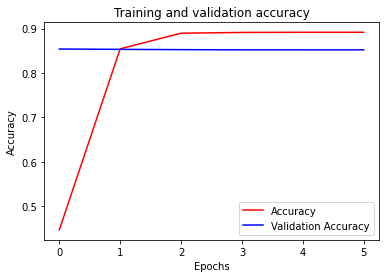

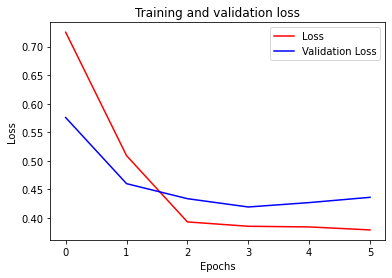

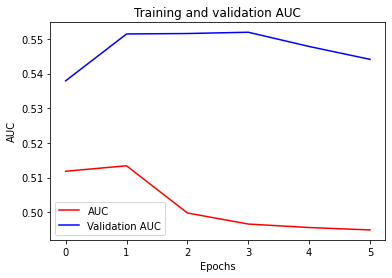

<Figure size 432x288 with 0 Axes>

In [122]:
acc=results.history['accuracy']
val_acc=results.history['val_accuracy']
loss=results.history['loss']
val_loss=results.history['val_loss']

auc = results.history['auc']
val_auc = results.history['val_auc']

epochs=range(len(acc)) # Get number of epochs

#------------------------------------------------
# Plot training and validation accuracy per epoch
#------------------------------------------------
plt.plot(epochs, acc, 'r')
plt.plot(epochs, val_acc, 'b')
plt.title('Training and validation accuracy')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(["Accuracy", "Validation Accuracy"])

plt.figure()

#------------------------------------------------
# Plot training and validation loss per epoch
#------------------------------------------------
plt.plot(epochs, loss, 'r')
plt.plot(epochs, val_loss, 'b')
plt.title('Training and validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(["Loss", "Validation Loss"])

plt.figure()

#------------------------------------------------
# Plot training and validation AUC per epoch
#------------------------------------------------
plt.plot(epochs, auc, 'r')
plt.plot(epochs, val_auc, 'b')
plt.title('Training and validation AUC')
plt.xlabel("Epochs")
plt.ylabel("AUC")
plt.legend(["AUC", "Validation AUC"])

plt.figure()

In [124]:
test_image = imread('test/392-seg.jpg')
test_image = resize(test_image, (256, 256), mode='constant', preserve_range=True)

FileNotFoundError: No such file: '/home/joseph/Desktop/U-Net-Semantic-Segmentation/test/392-seg.jpg'

In [125]:
test_image.shape

(128, 128, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


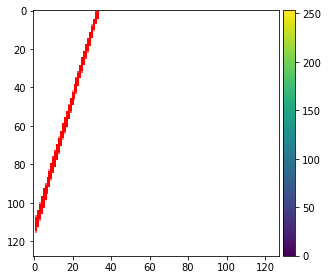

In [126]:
imshow(test_image)

In [127]:
test_path = 'test/'
sub_test = sorted(os.listdir(test_path))
X_test= np.zeros((len(sub_test), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
for i in range(len(sub_test)):
    img = imread(test_path +'/'+sub_test[i])
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_test[i] = img

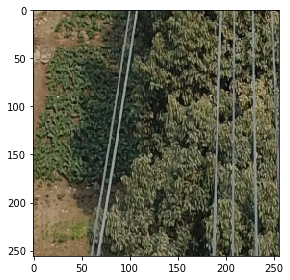

In [128]:
imshow(X_test[0])

In [129]:
preds = model.predict(X_test)

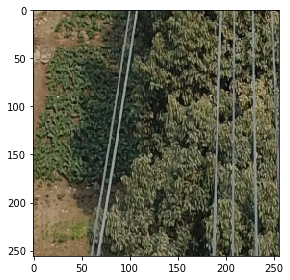

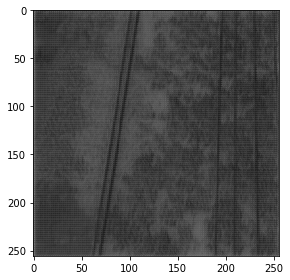

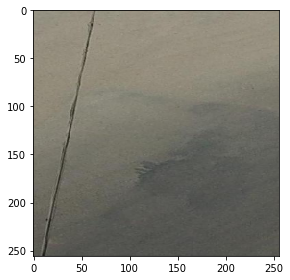

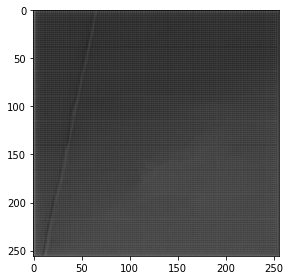

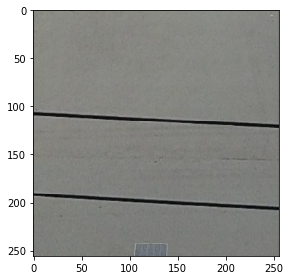

...

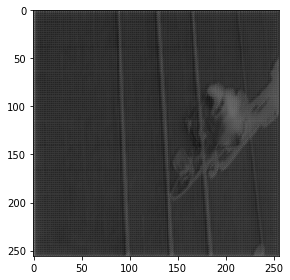

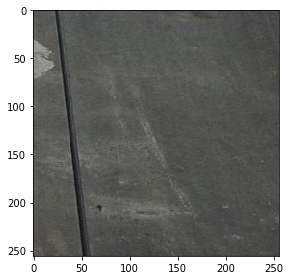

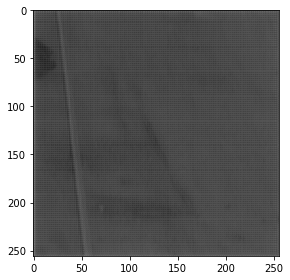

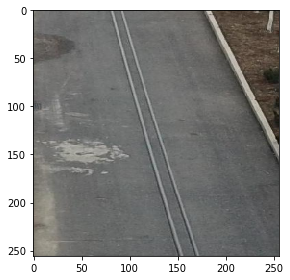

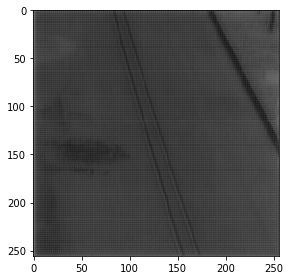

In [130]:
for i in range(len(preds)):
    imshow(X_test[i])
    plt.show()
    imshow(preds[i],cmap='gray')
    plt.show()
    

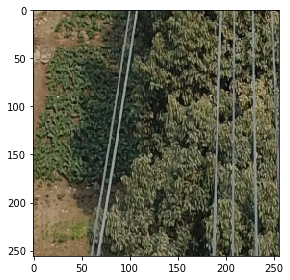

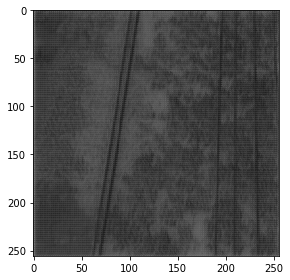

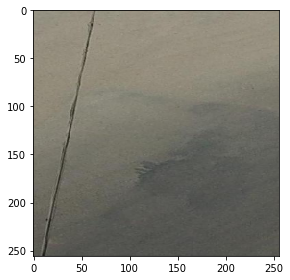

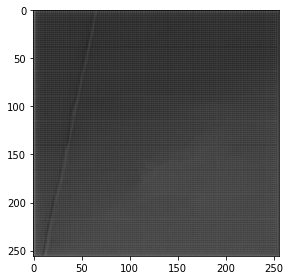

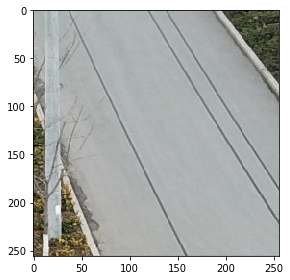

...

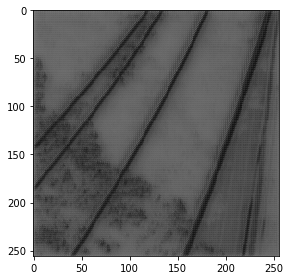

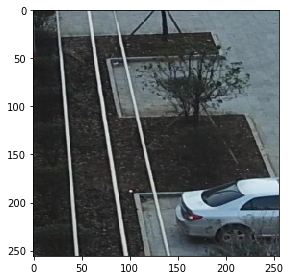

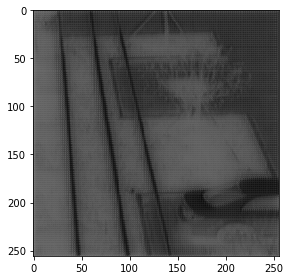

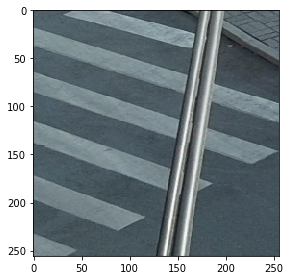

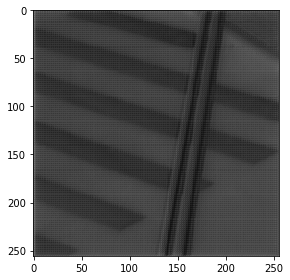

In [132]:
preds = model.predict(X_train[:10])
for i in range(10):
    imshow(X_train[i])
    plt.show()
    imshow(preds[i],cmap='gray')
    plt.show()
    